In [3]:
import time
import json
import pprint as pp

from IPython.display import display, Markdown, Latex
#display(Markdown('*some markdown* $\phi$'))

import pandas as pd
from IPython.display import display, HTML

from shapely.geometry import box
from shapely.geometry import Point
import shapely.geometry

from shapely import wkt


# from gbdx_auth import gbdx_auth
# gbdx = gbdx_auth.get_session()

from gbdxtools import Interface
gbdx = Interface()


from gbdxtools.task import env
from gbdxtools import CatalogImage, WV03_VNIR, WV03_SWIR  

%matplotlib inline

In [45]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

def plot(image, w=30, h=24, cmap='jet'):
    f, ax = plt.subplots(1, figsize=(w,h))
    ax.axis('off')
    plt.imshow(image, cmap=cmap)
    plt.colorbar()
    plt.show()

def climplot(image,lower,upper, w=30, h=24,  cmap='jet'):
    f, ax = plt.subplots(1, figsize=(w,h))
    ax.axis('off')
    plt.imshow(image, cmap=cmap)
    plt.colorbar()
    plt.clim(lower, upper)
    plt.show()

In [36]:
def calc_ecarr_redred(cimg):
    green = cimg[2,:,:]
    red = cimg[4,:,:]
    rededge = cimg[5,:,:]
    ecarr = 0.0161 * ((red/(green*red)) ** 0.7784)
    return(ecarr)

In [6]:
blooms = pd.read_csv("newblooms.csv")
display(blooms)

,long,lat
0,153.024202,-29.194401
1,152.965632,-29.057304
2,153.032432,-29.011527
3,153.142790,-28.967884
4,153.101445,-28.823379
5,153.123300,-28.742677
6,153.149534,-28.730539
7,153.181088,-28.720017
8,153.293630,-28.726067
9,153.289754,-28.928794


In [54]:
pointList = []
for i in range(len(blooms)):
    x = blooms.iloc[i]
    pointList.append(Point(x.long,x.lat))

poly = shapely.geometry.Polygon([[p.x, p.y] for p in pointList]).buffer(0.05)

In [56]:
poly.bounds
wkt.dumps(poly)

'MULTIPOLYGON (((153.0869436905976215 -29.0437372921561412, 153.0930329420553733 -28.9642145523641688, 153.0936115691819737 -28.9595507313626719, 153.0946255158779934 -28.9549618374018891, 153.0960658245182344 -28.9504884106721327, 153.0979197708194874 -28.9461699712783513, 153.1001709762520591 -28.9420446701031757, 153.1027995527346093 -28.9381489517661912, 153.1057822783334927 -28.9345172326570825, 153.1090928024150912 -28.9311815968869865, 153.1686644492414473 -28.8765505526312474, 153.1908611100318183 -28.9541301503458968, 153.1919778980689841 -28.9589089967379429, 153.1926208179952766 -28.9637743068336277, 153.1927836760259538 -28.9686792090365870, 153.1924649032135619 -28.9735764503266253, 153.1916675705629416 -28.9784188514875147, 153.1903993594455073 -28.9831597616238064, 153.1886724875983816 -28.9877535075878647, 153.1865035914205748 -28.9921558339874679, 153.1839135657007489 -28.9963243295349500, 153.1809273623202046 -29.0002188356305801, 153.1775737498706462 -29.003801833243

In [2]:
def findImageryFromLocation(n,start,end):
    x = blooms.iloc[n]
    bloomwkt = wkt.dumps(Point(x.long,x.lat).buffer(0.01))
    types = [ "DigitalGlobeAcquisition" ]
    results = gbdx.catalog.search(searchAreaWkt=bloomwkt,
                          startDate=start,
                          endDate=end,
                          types=types)
    
    rvv = pd.io.json.json_normalize(results)
    rv = rvv[['identifier','properties.timestamp','properties.cloudCover']]
    return(rv)

In [34]:
findImageryFromLocation(0,"2018-01-20T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010BB8100,2018-06-29T23:57:06.000Z,6
1,1020010076229500,2018-07-29T02:53:46.000Z,18
2,1030010083D1C500,2018-07-23T23:51:40.000Z,0
3,1020010077902900,2018-08-11T02:50:53.000Z,1
4,10200100756B3000,2018-07-12T02:51:24.000Z,70
5,102001006FA1C900,2018-03-15T02:51:48.000Z,24


In [35]:
order_id_0 = gbdx.ordering.order(['1030010083D1C500','1020010077902900'])
print(order_id_0)

e70f5526-8d40-4fcd-a6bc-b3c2196301b1


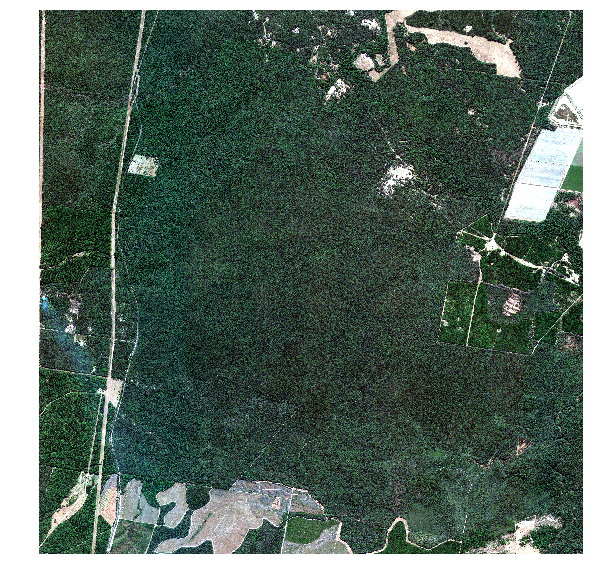

In [65]:
x0 = blooms.iloc[0]
p0large = Point(x0.long,x0.lat).buffer(0.05)
bloom0_7_23_large = CatalogImage('1030010083D1C500',bbox=p0large.bounds)
bloom0_7_23_large.plot()
#bloom0_8_11 = CatalogImage('1020010077902900',bbox=p0.bounds)

In [67]:
x0 = blooms.iloc[0]
p0large = Point(x0.long,x0.lat).buffer(0.04)
bloom0_7_23_large = CatalogImage('1030010083D1C500',bbox=p0large.bounds)
bloom0_7_23_large.plot(w=20,h=20)
#bloom0_8_11 = CatalogImage('1020010077902900',bbox=p0.bounds)

BadRequest: Problem fetching image metadata: status 403 , graph_id: 0fbbba655acc74440ea16da0bbd5144abe54ad6b4f6f702640fcd60f1149f0a1

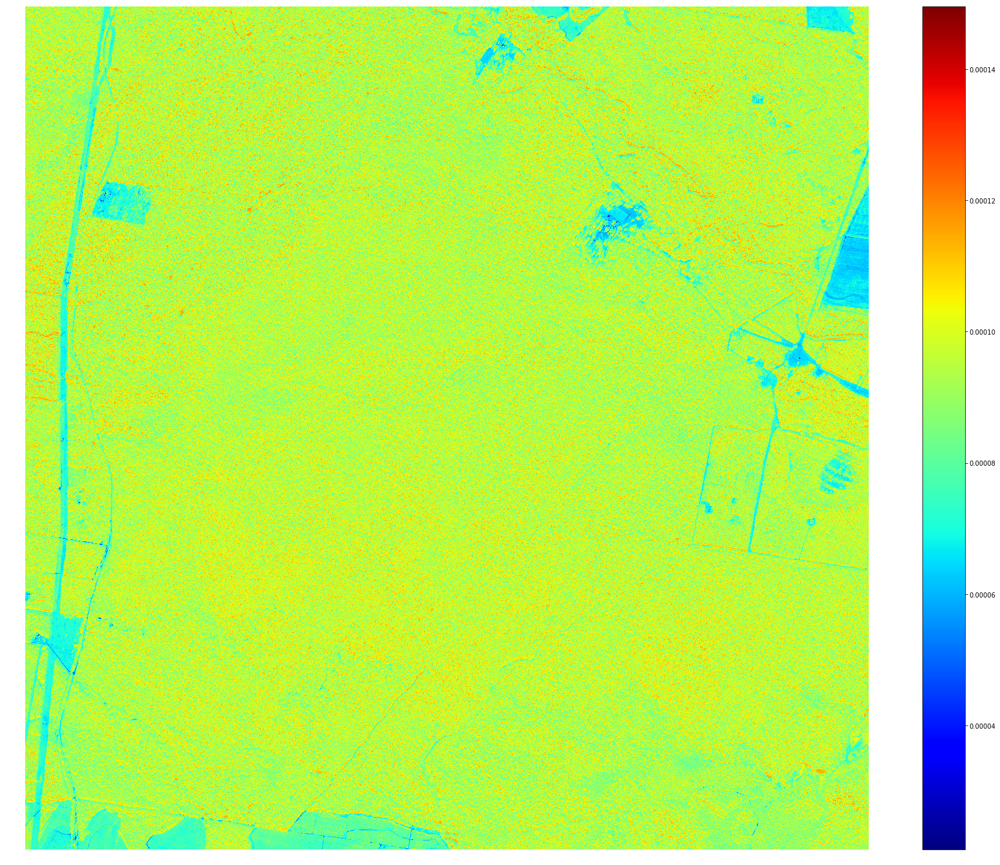

In [49]:
tredred0 = calc_ecarr_redred(bloom0_7_23_large)
plot(tredred0)

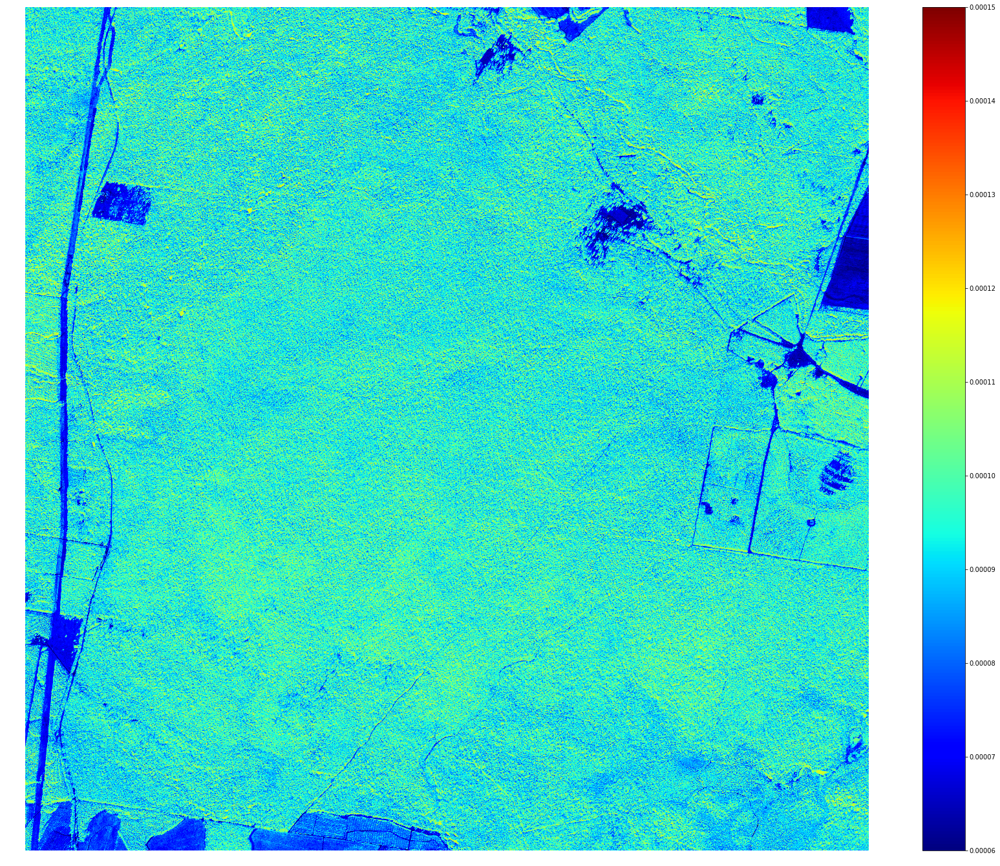

In [50]:
climplot(tredred0,0.00006,0.00015)

In [44]:
x0 = blooms.iloc[0]
p0 = Point(x0.long,x0.lat).buffer(0.01)
bloom0_7_23 = CatalogImage('1030010083D1C500',bbox=p0.bounds)
bloom0_8_11 = CatalogImage('1020010077902900',bbox=p0.bounds)

In [50]:
r = gbdx.catalog.get('1030010083D1C500')

In [51]:
r

{'identifier': '1030010083D1C500',
 'properties': {'browseURL': 'https://api.discover.digitalglobe.com/show?id=1030010083D1C500&f=jpeg',
  'catalogID': '1030010083D1C500',
  'cloudCover': 0,
  'footprintWkt': 'MULTIPOLYGON(((152.9490846 -28.97596222, 153.1630543 -28.98780569, 153.1630991 -29.03530859, 153.1630201 -29.08271976, 153.1628736 -29.1300681, 153.1628336 -29.1773993, 153.1627519 -29.22466035, 153.1628149 -29.27190856, 153.1629154 -29.31912509, 153.1625707 -29.3661832, 153.1624559 -29.41325409, 153.1622482 -29.46026394, 153.162404 -29.50730483, 153.1622123 -29.55424887, 153.162445 -29.60122388, 153.1621346 -29.64802089, 153.1620351 -29.69482995, 153.1620146 -29.74161171, 153.1620431 -29.78837121, 153.1621872 -29.83510397, 153.1617685 -29.88168756, 153.1617625 -29.92830562, 153.1616566 -29.97487656, 153.1615222 -30.01896482, 152.9518147 -30.01235893, 152.9511816 -29.96811317, 152.9508633 -29.92127206, 152.9507993 -29.8744421, 152.950565 -29.8275386, 152.9507261 -29.78065899, 152

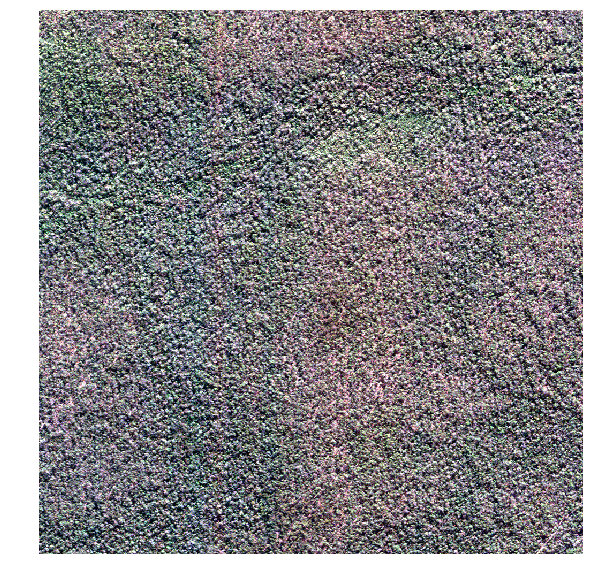

In [45]:
bloom0_7_23aoi = bloom0_7_23.aoi(wkt=wkt.dumps(p0))
bloom0_7_23aoi.plot()

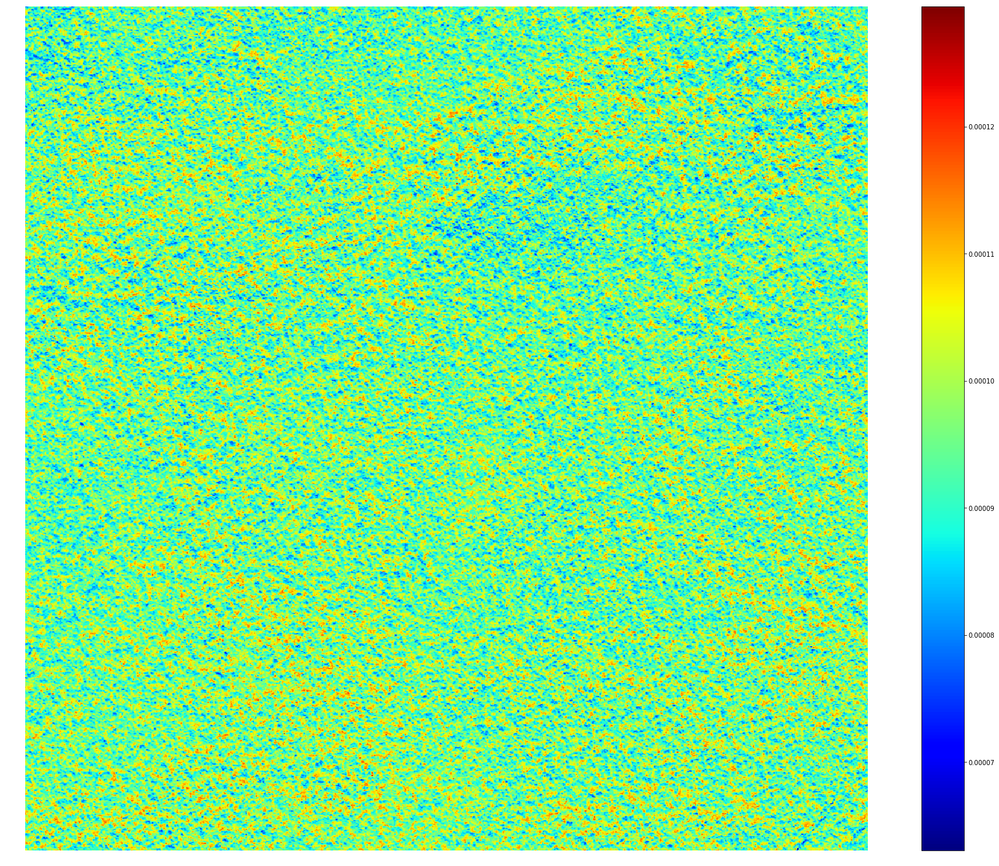

In [46]:
tredred = calc_ecarr_redred(bloom0_7_23aoi)
plot(tredred)

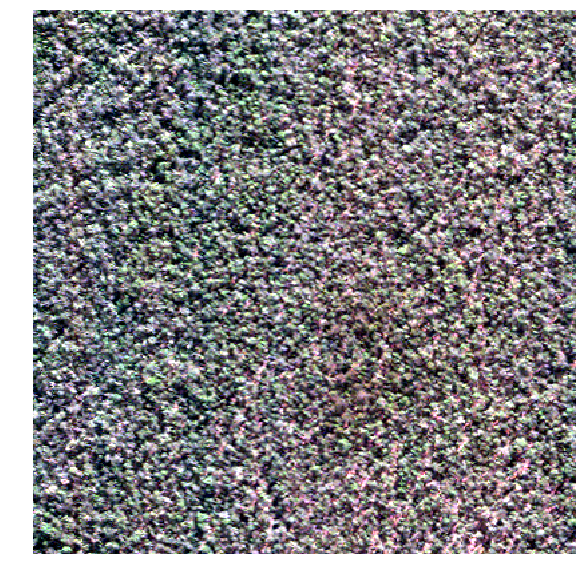

In [62]:
x0 = blooms.iloc[0]
bloom0_7_23aoi = bloom0_7_23.aoi(wkt=wkt.dumps(Point(x0.long,x0.lat).buffer(0.004)))
bloom0_7_23aoi.plot()

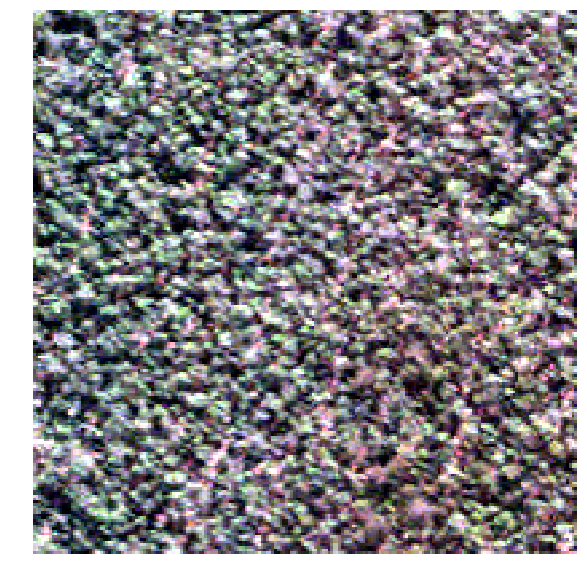

In [64]:
x0 = blooms.iloc[0]
bloom0_7_23aoix = bloom0_7_23.aoi(wkt=wkt.dumps(Point(x0.long,x0.lat).buffer(0.002)), pansharpen=True)
bloom0_7_23aoix.plot()

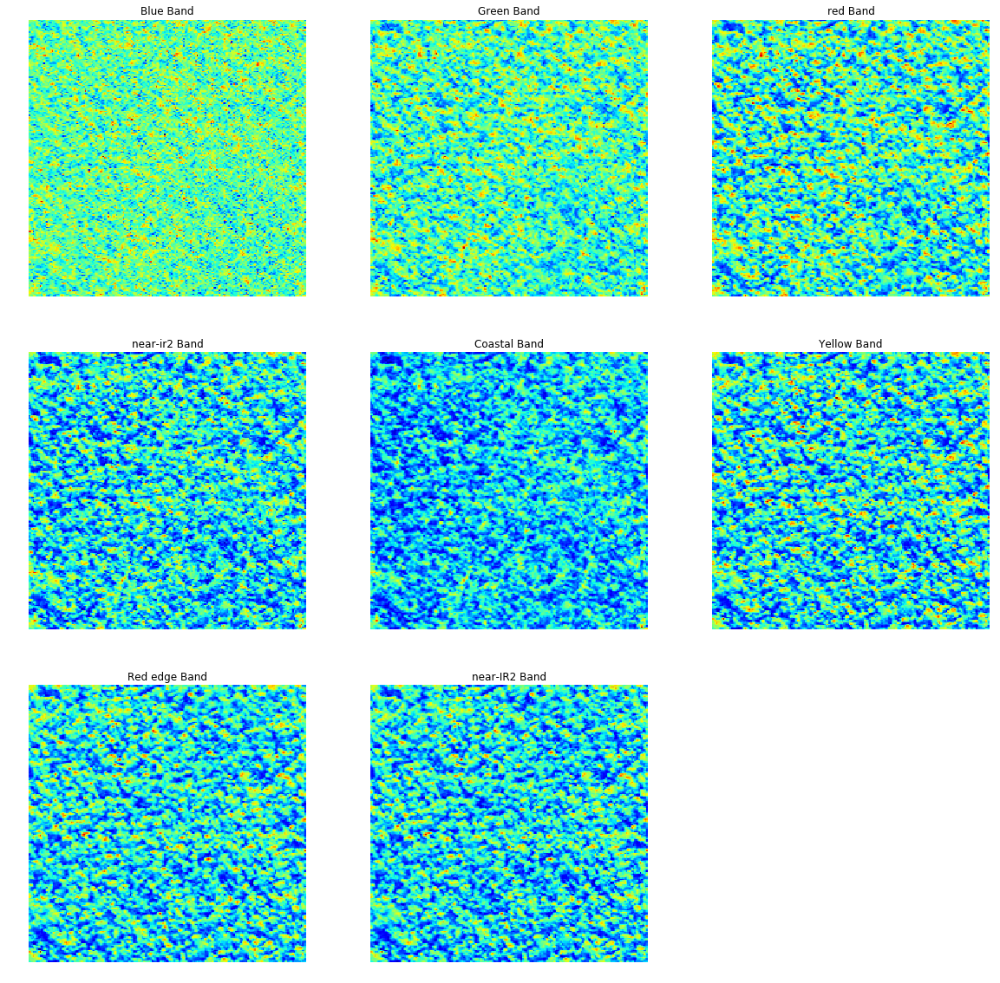

In [48]:
import matplotlib.pyplot as plt
#Multispectral 4-band: 4 standard VNIR colors are blue, green, red, near-IR1
#Multispectral 8-band: 4 additional VNIR colors are coastal, yellow, red edge, and near-IR2
bands = ["Blue", "Green", "red", "near-ir2","Coastal",  "Yellow", "Red edge","near-IR2"]
plt.figure(figsize=(20,20))
for i in range(8):
    plt.subplot(3, 3, i+1)
    plt.axis('off')
    plt.imshow(bloom0_7_23aoix[i,...], cmap="jet")
    plt.title("{} Band".format(bands[i]))
plt.show()


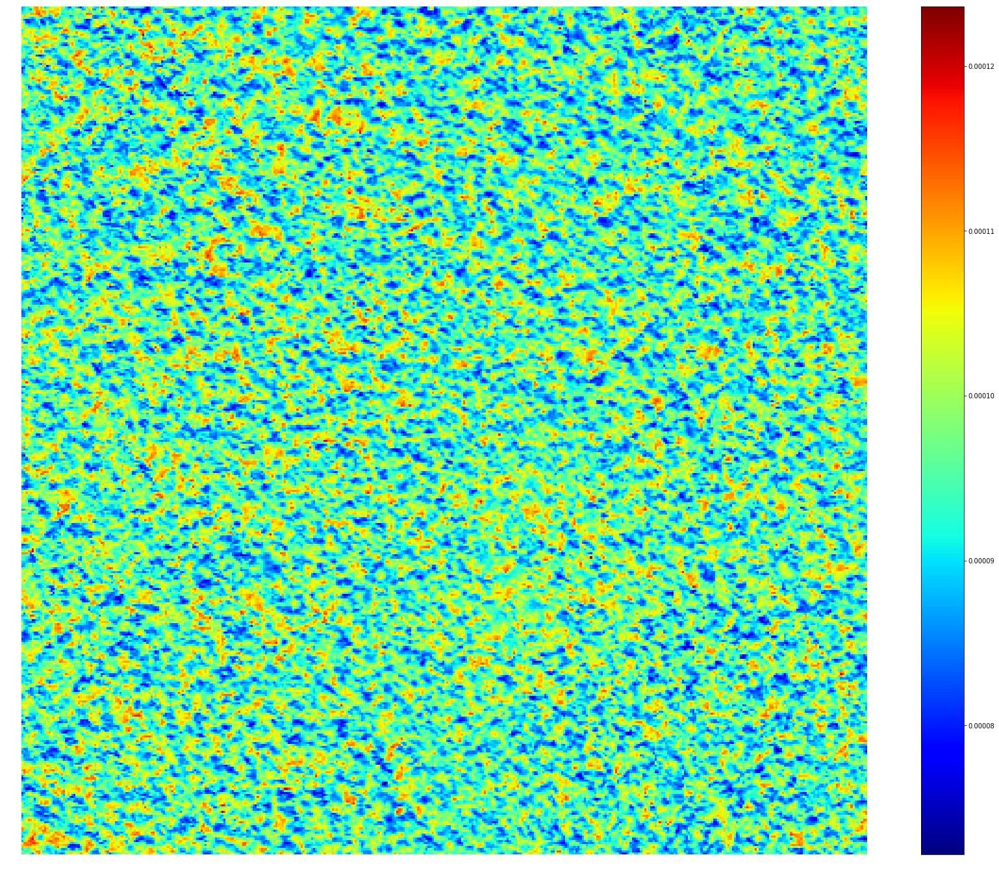

In [63]:
tredred = calc_ecarr_redred(bloom0_7_23aoi)
plot(tredred)

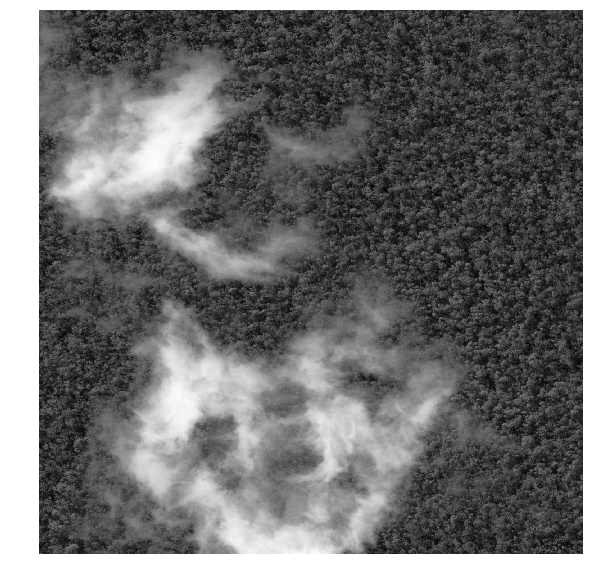

In [60]:
x0 = blooms.iloc[0]
bloom0_8_11aoi = bloom0_8_11.aoi(wkt=wkt.dumps(Point(x0.long,x0.lat).buffer(0.004)))
bloom0_8_11aoi.plot()

In [65]:
bloom0_8_11aoi.shape

(1, 1512, 1512)

In [36]:
findImageryFromLocation(1,"2018-01-20T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1030010083D1C500,2018-07-23T23:51:40.000Z,0
1,10200100756B3000,2018-07-12T02:51:24.000Z,70
2,1030010080257000,2018-07-04T23:50:01.000Z,99
3,102001006FA1C900,2018-03-15T02:51:48.000Z,24


In [37]:
order_id_1 = gbdx.ordering.order(['102001006FA1C900','1030010083D1C500'])
print(order_id_1)

e8ad9e50-6d66-463a-a2d4-f821b9eb0dc0


In [40]:
findImageryFromLocation(2,"2018-06-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010BB8100,2018-06-29T23:57:06.000Z,6
1,1020010076229500,2018-07-29T02:53:46.000Z,18
2,1030010083D1C500,2018-07-23T23:51:40.000Z,0
3,1020010077902900,2018-08-11T02:50:53.000Z,1
4,10200100756B3000,2018-07-12T02:51:24.000Z,70


In [41]:
order_id_2 = gbdx.ordering.order(['1030010083D1C500','1020010077902900'])
print(order_id_2)

04b28dcb-80bc-4c24-a93e-9dbec33eaa9c


In [67]:
x2 = blooms.iloc[2]
bloom2_7_29 = CatalogImage('1030010083D1C500',bbox=Point(x2.long,x2.lat).buffer(0.01).bounds)
bloom2_8_11 = CatalogImage('1020010077902900',bbox=Point(x2.long,x2.lat).buffer(0.01).bounds)

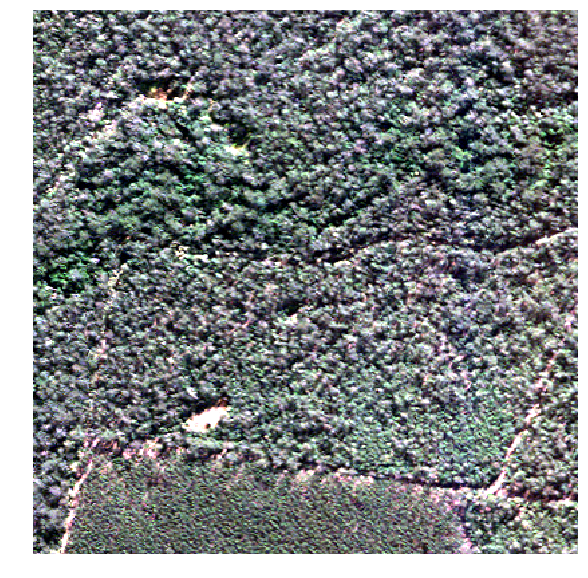

In [68]:
x2 = blooms.iloc[2]
bloom2_7_29aoi = bloom2_7_29.aoi(wkt=wkt.dumps(Point(x2.long,x2.lat).buffer(0.004)))
bloom2_7_29aoi.plot()

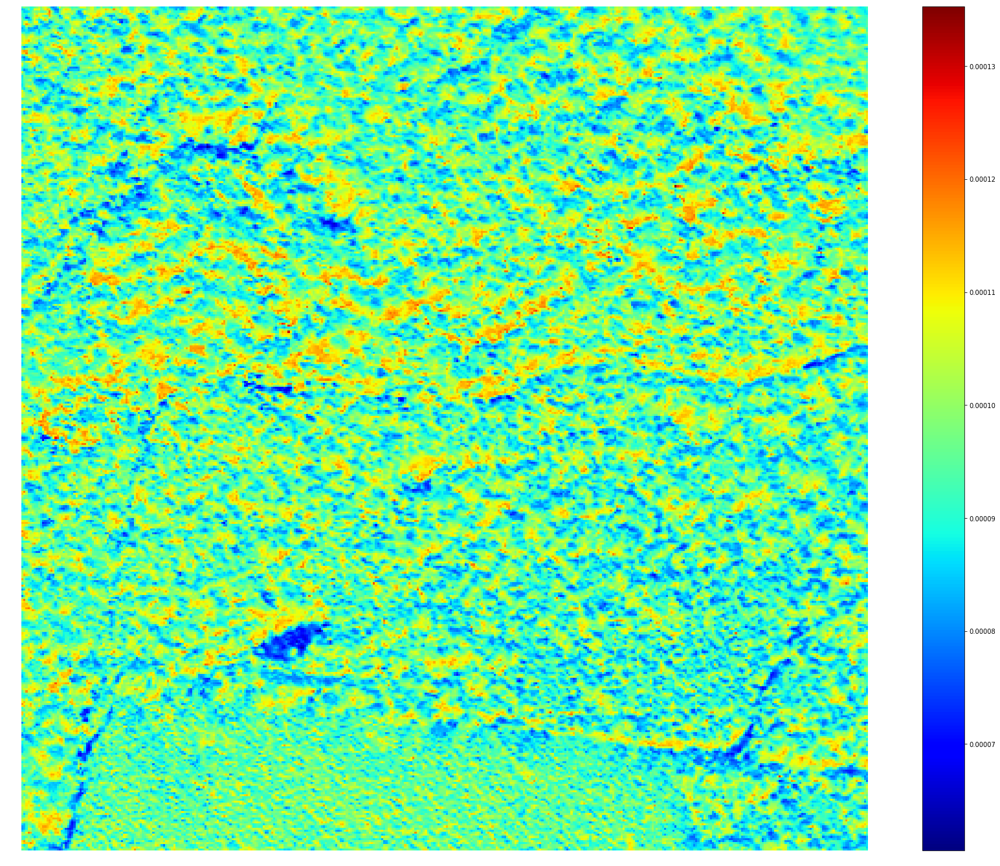

In [69]:
tredred_2_7_29 = calc_ecarr_redred(bloom2_7_29aoi)
plot(tredred_2_7_29)

In [44]:
findImageryFromLocation(3,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010BB8100,2018-06-29T23:57:06.000Z,6
1,1020010076229500,2018-07-29T02:53:46.000Z,18
2,1020010077902900,2018-08-11T02:50:53.000Z,1
3,1050010011034800,2018-07-07T23:49:14.000Z,0


In [45]:
order_id_3 = gbdx.ordering.order(['1050010011034800','1020010077902900'])
print(order_id_3)

3886b58d-3065-48b9-b5dd-fc4714662c3e


In [100]:
x3 = blooms.iloc[3]
bloom3_7_7 = CatalogImage('1050010011034800',bbox=Point(x3.long,x3.lat).buffer(0.0001).bounds)
bloom3_8_11 = CatalogImage('1020010077902900',bbox=Point(x3.long,x3.lat).buffer(0.0001).bounds)

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/gbdxtools/images/meta.py:440: UserWarning: Image does not contain specified geometry (153.14269, -28.967984000000005, 153.14289, -28.967784) not in (153.14351246, -29.017498677261948, 153.33322648263746, -28.46950254)
  warnings.warn(ae.args)


In [47]:
# Nothing after June
findImageryFromLocation(4,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010BB8100,2018-06-29T23:57:06.000Z,6
1,103001007E94D200,2018-06-29T00:10:44.000Z,0
2,104001003C9C3D00,2018-05-13T00:19:18.000Z,0
3,104001003C619200,2018-05-13T00:20:08.000Z,0


In [48]:
findImageryFromLocation(5,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010BB8100,2018-06-29T23:57:06.000Z,6
1,104001003C9C3D00,2018-05-13T00:19:18.000Z,0
2,104001003C619200,2018-05-13T00:20:08.000Z,0


In [49]:
findImageryFromLocation(6,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010BB8100,2018-06-29T23:57:06.000Z,6
1,1050010011034800,2018-07-07T23:49:14.000Z,0


In [50]:
findImageryFromLocation(7,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010BB8100,2018-06-29T23:57:06.000Z,6
1,1050010010C79100,2018-07-03T00:05:31.000Z,24
2,1050010011034800,2018-07-07T23:49:14.000Z,0


In [51]:
findImageryFromLocation(8,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010C79100,2018-07-03T00:05:31.000Z,24
1,1050010011034800,2018-07-07T23:49:14.000Z,0


In [54]:
findImageryFromLocation(9,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010C79100,2018-07-03T00:05:31.000Z,24
1,1050010011034800,2018-07-07T23:49:14.000Z,0


In [55]:
findImageryFromLocation(10,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010C79200,2018-07-03T00:06:03.000Z,15
1,1030010081367700,2018-06-29T00:10:36.000Z,0
2,1050010011034900,2018-07-07T23:49:46.000Z,0
3,103001007D710400,2018-06-12T23:58:32.000Z,25


In [56]:
findImageryFromLocation(11,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010C79200,2018-07-03T00:06:03.000Z,15
1,6960f9af-bc8a-45ae-8807-4a9dc0fb7b59-inv,2018-08-22T23:55:37.000Z,1
2,1030010081367700,2018-06-29T00:10:36.000Z,0
3,1050010011034900,2018-07-07T23:49:46.000Z,0
4,103001007D710400,2018-06-12T23:58:32.000Z,25


In [7]:
ids = list(findImageryFromLocation(11,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")['identifier'])
print(ids)

['1050010010C79200', '6960f9af-bc8a-45ae-8807-4a9dc0fb7b59-inv', '1050010011034900', '1030010081367700', '103001007D710400']


In [25]:
order_id_11 = gbdx.ordering.order(['1050010010C79200', '1050010011034900', '1030010081367700', '103001007D710400'])
print(order_id_11)

b485d3c0-87dd-46dc-bc0a-8753a5a8e512


In [57]:
findImageryFromLocation(12,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010C79200,2018-07-03T00:06:03.000Z,15
1,6960f9af-bc8a-45ae-8807-4a9dc0fb7b59-inv,2018-08-22T23:55:37.000Z,1
2,1050010011034900,2018-07-07T23:49:46.000Z,0
3,1030010081367700,2018-06-29T00:10:36.000Z,0
4,103001007D710400,2018-06-12T23:58:32.000Z,25


In [58]:
findImageryFromLocation(13,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010C79200,2018-07-03T00:06:03.000Z,15
1,103001008047C600,2018-08-09T00:02:50.000Z,0
2,1050010011034900,2018-07-07T23:49:46.000Z,0


In [59]:
order_id_13 = gbdx.ordering.order(['1050010011034900','103001008047C600'])
print(order_id_13)

3782c117-36e2-49d7-b4af-70a8aad15ca2


In [53]:
x13 = blooms.iloc[13]
#bloom13_7_7 = CatalogImage('103001008047C600',bbox=Point(x13.long,x13.lat).buffer(0.0001).bounds)
bloom13_8_9 = CatalogImage('1050010011034900',bbox=Point(x13.long,x13.lat).buffer(0.001).bounds)

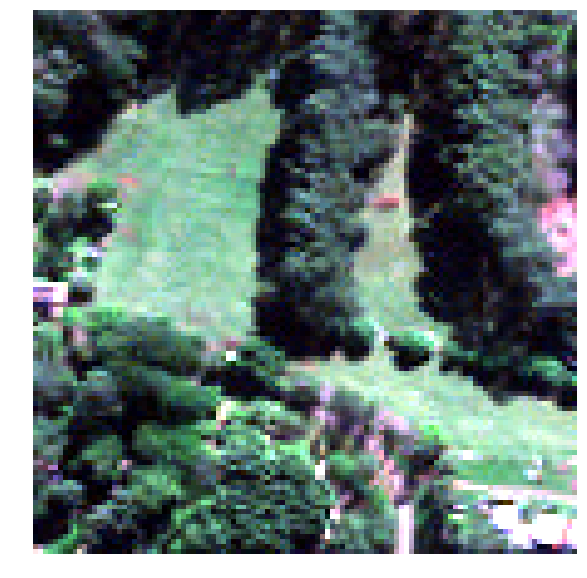

In [54]:
x13 = blooms.iloc[13]
bloom13_8_9aoi = bloom13_8_9.aoi(wkt=wkt.dumps(Point(x13.long,x13.lat).buffer(0.001)))
bloom13_8_9aoi.plot()

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/gbdxtools/images/meta.py:440: UserWarning: Image does not contain specified geometry (153.40748999999997, -28.650986999999997, 153.41149, -28.646987) not in (153.40848999999997, -28.649987, 153.41048999999998, -28.647986999999997)
  warnings.warn(ae.args)


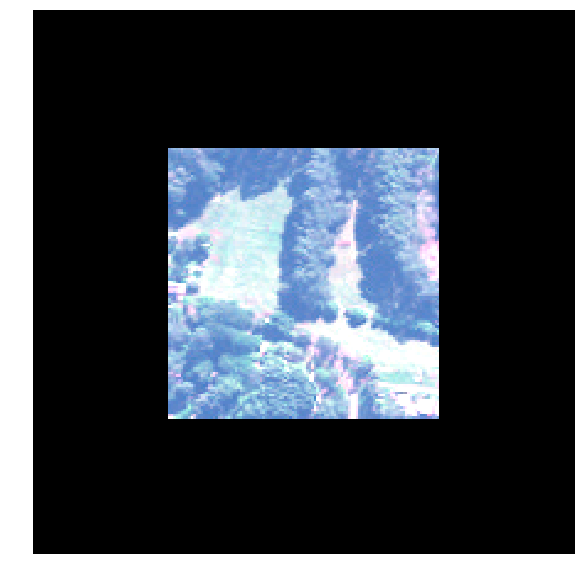

In [56]:
x13 = blooms.iloc[13]
bloom13_8_9aoi = bloom13_8_9.aoi(wkt=wkt.dumps(Point(x13.long,x13.lat).buffer(0.002)),pansharpen=True)
bloom13_8_9aoi.plot()

In [75]:
tredred_13_8_9 = calc_ecarr_redred(bloom13_8_9aoi)
plot(tredred_13_8_9)

IndexError: Index is not smaller than dimension 4 >= 4

In [91]:
x13

long    153.409490
lat     -28.648987
Name: 13, dtype: float64

In [61]:
findImageryFromLocation(14,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010C79200,2018-07-03T00:06:03.000Z,15
1,1050010011034900,2018-07-07T23:49:46.000Z,0
2,1030010081367700,2018-06-29T00:10:36.000Z,0
3,103001007D710400,2018-06-12T23:58:32.000Z,25


In [62]:
findImageryFromLocation(15,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010BB8100,2018-06-29T23:57:06.000Z,6
1,1020010076229500,2018-07-29T02:53:46.000Z,18
2,1020010077902900,2018-08-11T02:50:53.000Z,1
3,1050010011034800,2018-07-07T23:49:14.000Z,0


In [63]:
findImageryFromLocation(16,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1020010077902900,2018-08-11T02:50:53.000Z,1
1,1050010010BB8100,2018-06-29T23:57:06.000Z,6
2,1030010083D1C500,2018-07-23T23:51:40.000Z,0
3,1020010076229500,2018-07-29T02:53:46.000Z,18
4,10200100756B3000,2018-07-12T02:51:24.000Z,70
5,1020010075CBC300,2018-07-12T02:51:10.000Z,49


In [33]:
def findImageryFromLocationAugust(blooms,buffer_radius):
    fnd = 0
    for i in range(len(blooms)):
        x = blooms.iloc[i]
        bloomwkt = wkt.dumps(Point(x.long,x.lat).buffer(buffer_radius))
        types = [ "DigitalGlobeAcquisition" ]
        results = gbdx.catalog.search(searchAreaWkt=bloomwkt,
                          startDate="2018-08-01T00:00:00.000Z",
                          endDate="2018-09-01T00:00:00.000Z",
                          types=types)
    
        if(len(results)>0):
            print(i," ",len(results))
            print(results[0]['identifier'])
            print(results)
            fnd += 1
    return(fnd)

In [65]:
found = findImageryFromLocationAugust(blooms)

0
2
3
11
12
13
15
16


In [111]:
found = findImageryFromLocationAugust(blooms,0.001)

0   1
2   1
11   1
12   1
16   1


In [77]:
#found = findImageryFromLocationAugust(blooms,0.01)

In [66]:
found

8

In [78]:
# https://api.discover.digitalglobe.com/show?id=103001008047C600
#103001008047C600
order_idx = gbdx.ordering.order(['103001008047C600'])
print(order_idx)

fb9dd4c5-472e-47c3-9585-ebff2251fbce


In [32]:
nLismore80918 = CatalogImage('103001008047C600')

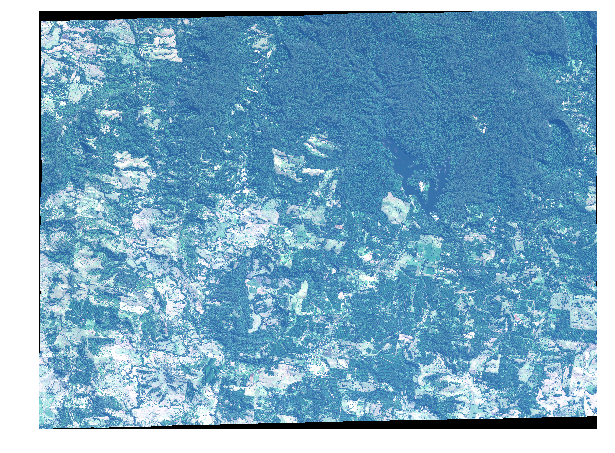

In [33]:
nLismore80918.plot()

In [ ]:
#catalog_ids = [r['identifier'] for r in results]

In [79]:
# highly overlapping 6/12 and 6/29 near Lismore
# not a ton of vegeation but good for comparison?
order_idxd = gbdx.ordering.order(['1030010081367700','103001007D710400'])
print(order_idxd)

1b507c51-58f7-4053-b40d-2342286feb41


In [6]:
nLismore62918 = CatalogImage('1030010081367700')
nLismore61218 = CatalogImage('103001007D710400')

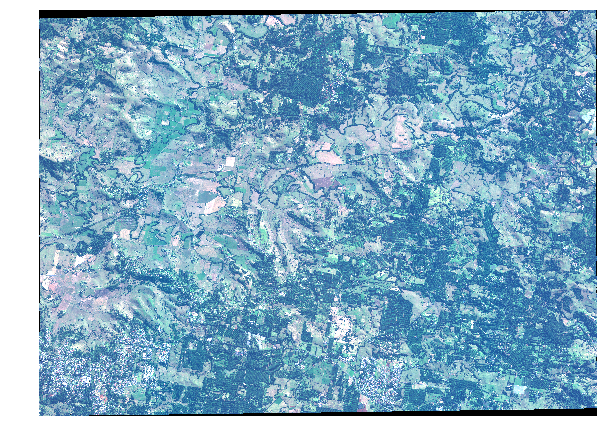

In [10]:
nLismore62918.plot()

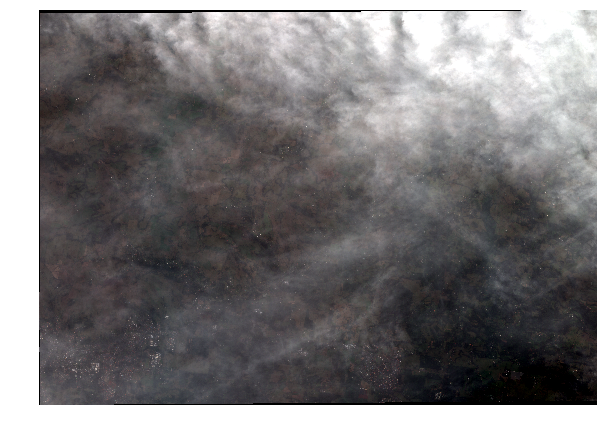

In [8]:
nLismore61218.plot()

In [14]:
nLismore61218acomp = CatalogImage('103001007D710400',acomp=True)

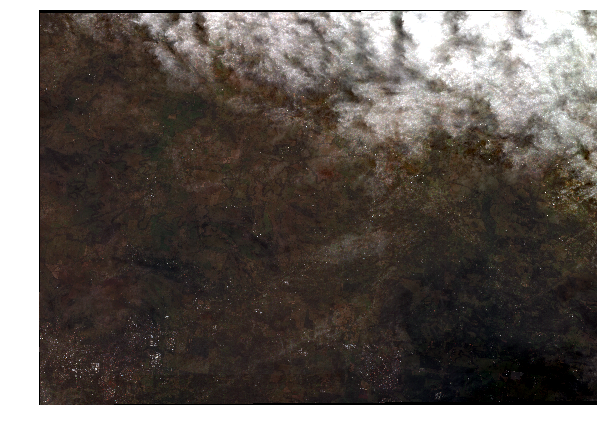

In [30]:
nLismore61218acomp.plot()

In [11]:
# 
blooms = pd.read_csv("newblooms.csv")

pointList = []
for i in range(len(blooms)):
    x = blooms.iloc[i]
    pointList.append(Point(x.long,x.lat))


poly = shapely.geometry.Polygon([[p.x, p.y] for p in pointList]).buffer(0.05)

#print(poly.wkt)  # prints: 'POLYGON ((0 0, 1 0, 1 1, 0 1, 0 0))'

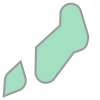

In [9]:
poly

In [27]:
blooms = pd.read_csv("newblooms.csv")

pointList = []
for i in range(len(blooms)):
    x = blooms.iloc[i]
    pointList.append(Point(x.long,x.lat))

from random import shuffle

#shuffle(pointList)

poly = shapely.geometry.Polygon([[p.x, p.y] for p in pointList])

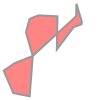

In [28]:
poly

In [29]:
print(poly.wkt)

POLYGON ((153.0242023 -29.1944006, 152.965632 -29.057304, 153.032432 -29.011527, 153.14279 -28.967884, 153.101445 -28.823379, 153.1233 -28.742677, 153.149534 -28.730539, 153.181088 -28.720017, 153.29363 -28.726067, 153.289754 -28.928794, 153.392324 -28.791952, 153.44007 -28.774929, 153.442747 -28.760784, 153.40949 -28.648987, 153.407635 -28.725241, 153.142887 -28.968032, 153.124055 -29.213969, 153.0242023 -29.1944006))


In [34]:
from shapely.geometry import mapping, Polygon
import fiona

# Here's an example Shapely geometry
#poly = Polygon([(0, 0), (0, 1), (1, 1), (0, 0)])

# Define a polygon feature geometry with one attribute
schema = {
    'geometry': 'Polygon',
    'properties': {'id': 'int'},
}

# Write a new Shapefile
with fiona.open('my_shp2.shp', 'w', 'ESRI Shapefile', schema) as c:
    ## If there are multiple geometries, put the "for" loop here
    c.write({
        'geometry': mapping(poly),
        'properties': {'id': 123},
    })

In [35]:
#1030010083486000 103001007FABE500
#https://api.discover.digitalglobe.com/show?id=103001007FABE500
order_idxd = gbdx.ordering.order(['1030010083486000','103001007FABE500'])
print(order_idxd)

25bf2319-cb47-4843-93cc-d49ab67183af


In [57]:
nLismore72318 = CatalogImage('1030010083486000')
nLismore71218 = CatalogImage('103001007FABE500')

In [ ]:
# find shared overlap

In [59]:
gbdx.catalog.get('103001007FABE500')

{'identifier': '103001007FABE500',
 'properties': {'browseURL': 'https://api.discover.digitalglobe.com/show?id=103001007FABE500&f=jpeg',
  'catalogID': '103001007FABE500',
  'cloudCover': 0,
  'footprintWkt': 'MULTIPOLYGON(((153.1759756 -29.01017433, 153.3690483 -29.02705783, 153.36895 -29.07648144, 153.3688662 -29.12583724, 153.3688569 -29.17518099, 153.3686877 -29.22416371, 153.3685708 -29.27312878, 153.3684738 -29.32205292, 153.3683883 -29.36865585, 153.1769535 -29.35373064, 153.1767067 -29.30676635, 153.1765876 -29.25757775, 153.1763856 -29.20821708, 153.176253 -29.15885057, 153.1761463 -29.1093771, 153.1760438 -29.05979694, 153.1759756 -29.01017433)))',
  'imageBands': 'PAN_MS1_MS2',
  'multiResolution': 2.1539633,
  'multiResolution_end': 2.13999,
  'multiResolution_max': 2.1702733,
  'multiResolution_min': 2.13999,
  'multiResolution_start': 2.1702733,
  'offNadirAngle': 22.321997,
  'offNadirAngle_end': 21.825712,
  'offNadirAngle_max': 22.890324,
  'offNadirAngle_min': 21.8257

In [ ]:
gbdx.catalog.get('103001007FABE500')['properties']['footprintWkt']
gbdx.catalog.get('1030010083486000')['properties']['footprintWkt']

In [61]:
from osgeo import ogr

wkt1 = gbdx.catalog.get('103001007FABE500')['properties']['footprintWkt']
wkt2 = gbdx.catalog.get('1030010083486000')['properties']['footprintWkt']

poly1 = ogr.CreateGeometryFromWkt(wkt1)
poly2 = ogr.CreateGeometryFromWkt(wkt2)

intersection = poly1.Intersection(poly2)

print(intersection.ExportToWkt())

POLYGON ((153.1759756 -29.01017433,153.354772198779 -29.0258094372704,153.3547827 -29.03390622,153.3548512 -29.08027151,153.3551459 -29.12661635,153.355271 -29.1729113,153.3551742 -29.21916093,153.3552948 -29.26544179,153.3553842 -29.31174248,153.3555783 -29.35803224,153.355618142427 -29.3676602249438,153.1769535 -29.35373064,153.1767067 -29.30676635,153.1765876 -29.25757775,153.1763856 -29.20821708,153.176253 -29.15885057,153.1761463 -29.1093771,153.1760438 -29.05979694,153.1759756 -29.01017433))


In [75]:
n712 = CatalogImage('103001007FABE500')#, wkt=intersection.ExportToWkt())
#n723 = CatalogImage('1030010083486000', wkt=intersection.ExportToWkt())

BadRequest: Problem fetching image metadata: status 403 , graph_id: 5e3ab07d608e2c0d06aea8f806af220ec128b691815d37e2d2298f4db787e18d

In [72]:
from gbdx_auth import gbdx_auth
gbdx = gbdx_auth.get_session()

from gbdxtools import Interface
gbdx = Interface()